# Methanotroph Enrichment 16S Amplicon Sequencing Analysis - Aug2022
Note: If getting "Exec format error" when trying to run usearch command. Troubleshooting:
Make sure to first run: sudo service binfmt-support start
to activate support for 32-bit executable. See this post:
https://stackoverflow.com/questions/42120938/exec-format-error-32-bit-executable-windows-subsystem-for-linux

In [3]:
! gunzip data/*.gz

In [7]:
#Merge all reads together
! $usearch -fastq_mergepairs data/soil/*R1*.fastq -relabel @ -fastqout soil_merged.fq

! $usearch -fastq_mergepairs data/low/*R1*.fastq -relabel @ -fastqout low_merged.fq

In [9]:
! $usearch -fastq_mergepairs data/high/*R1*.fastq -relabel @ -fastqout high_merged.fq

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only


Merging
  Fwd data/high/YK-7_R1_001.fastq
  Rev data/high/YK-7_R2_001.fastq
  Relabel reads as YK-7.#

00:00 4.4Gb  FASTQ base 33 for file data/high/YK-7_R1_001.fastq
00:47 4.9Gb   100.0% 92.0% merged
                                 
Merging
  Fwd data/high/YK-8_R1_001.fastq
  Rev data/high/YK-8_R2_001.fastq
  Relabel reads as YK-8.#

01:50 4.9Gb   100.6% 86.7% merged0% 86.7% merged
                                 
Merging
  Fwd data/high/YK-9_R1_001.fastq
  Rev data/high/YK-9_R2_001.fastq
  Relabel reads as YK-9.#

02:38 4.9Gb   100.0% 87.1% merged

Totals:
   3114620  Pairs (3.1M)
   2713485  Merged (2.7M, 87.12%)
   1740872  Alignments with zero diffs (55.89%)
    140803  Too many diffs (> 5) (4.52%)
     26606  Fwd tails Q <= 2 trimmed (0.85%)
       418  Rev tails Q <= 2 trimmed (0.01%)
     40726  Fw

In [85]:
! $usearch -sortbylength soil_merged.fq -fastqout soil_merged_sorted.fq -minseqlength 400
! $usearch -sortbylength low_merged.fq -fastqout low_merged_sorted.fq -minseqlength 400
! $usearch -sortbylength high_merged.fq -fastqout high_merged_sorted.fq -minseqlength 400

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:30 4.4Gb   100.0% Reading soil_merged.fq
00:30 4.4Gb  Sorting by length             
00:31 4.4Gb  Length min 47, median 413, max 484
00:39 4.4Gb   100.0% Writing output 247918 short, 0 long
00:39 4.4Gb  Write done, closing file and exiting       
usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:34 4.4Gb   100.0% Reading low_merged.fq
00:34 4.4Gb  Sorting by length            
00:35 4.4Gb  Length min 22, median 411, max 483
00:43 4.4Gb   100.0% Writing output 185213 short, 0 long
00:44 4.4Gb  Write done, closing file and exiting       
usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com

In [86]:
#Trim off primers 
! $usearch -fastx_truncate soil_merged_sorted.fq -stripleft 19 -stripright 20 -fastqout soil_merged_trimmed.fq
! $usearch -fastx_truncate low_merged_sorted.fq -stripleft 19 -stripright 20 -fastqout low_merged_trimmed.fq
! $usearch -fastx_truncate high_merged_sorted.fq -stripleft 19 -stripright 20 -fastqout high_merged_trimmed.fq

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:35 4.4Gb   100.0% Processing, 0 (0.0%) too shortrocessing, 0 (0.0%) too short
usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:41 4.4Gb   100.0% Processing, 0 (0.0%) too short
usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:41 4.4Gb   100.0% Processing, 0 (0.0%) too short9% Processing, 0 (0.0%) too shortocessing, 0 (0.0%) too short


In [87]:
# Quality filter
! $usearch -fastq_filter soil_merged_trimmed.fq -fastq_maxee 1.0 -relabel Filt -fastaout soil_merged_trimmed_filtered.fa
! $usearch -fastq_filter low_merged_trimmed.fq -fastq_maxee 1.0 -relabel Filt -fastaout low_merged_trimmed_filtered.fa
! $usearch -fastq_filter high_merged_trimmed.fq -fastq_maxee 1.0 -relabel Filt -fastaout high_merged_trimmed_filtered.fa

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:00 4.4Gb  FASTQ base 33 for file soil_merged_trimmed.fq
00:49 4.9Gb   100.0% Filtering, 86.5% passedFiltering, 86.3% passed
   1978521  Reads (2.0M)                    
    266585  Discarded reads with expected errs > 1.00
   1711936  Filtered reads (1.7M, 86.5%)
usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:00 4.4Gb  FASTQ base 33 for file low_merged_trimmed.fq
00:56 4.9Gb   100.0% Filtering, 88.2% passed.7% Filtering, 88.1% passedb    53.5% Filtering, 88.0% passed2% passed
   2308688  Reads (2.3M)                    
    271878  Discarded reads with expected errs > 1.00
   2036810  Filtered reads (2.0M, 88.2%)
usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 co

In [102]:
#Combine filtered sequences into one file so they can be processed together
! cat soil_merged_trimmed_filtered.fa >> all_filtered.fa
! cat low_merged_trimmed_filtered.fa >> all_filtered.fa
! cat high_merged_trimmed_filtered.fa >> all_filtered.fa

In [103]:
# Find unique read sequences and abundances
! $usearch -fastx_uniques all_filtered.fa -sizeout -relabel Uniq -fastaout all_filtered_uniques.fa

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

01:13 4.4Gb   100.0% Reading all_filtered.fa
01:47 4.9Gb   100.0% DF                     .6% DF
01:52 4.9Gb  5823166 seqs, 2159853 uniques, 1780076 singletons (82.4%)
01:52 4.9Gb  Min size 1, median 1, max 475135, avg 2.70
02:36 4.9Gb   100.0% Writing all_filtered_uniques.fa% Writing all_filtered_uniques.fa


In [104]:
#Denoise
! $usearch -unoise3 all_filtered_uniques.fa -zotus all_zotus.fa -tabbedout all_unoise3.txt

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:26 4.4Gb   100.0% Reading all_filtered_uniques.fa
00:26 4.4Gb     0.0% 0 amplicons, 0 bad (size >= 475135)

00:44 4.4Gb   100.0% 14194 amplicons, 1021152 bad (size >= 8)99 amplicons, 987333 bad (size >= 9)
18:26 4.4Gb   100.0% 8350 good, 5845 chimeras                14.0% 1474 good, 519 chimeras3.7% 3214 good, 1565 chimeras 34.8% 3307 good, 1631 chimeras8.4% 4388 good, 2480 chimeras51.8% 4660 good, 2693 chimeras.1% 4679 good, 2714 chimeras   53.2% 4774 good, 2778 chimeras3.8% 4814 good, 2820 chimeras8.2% 5157 good, 3098 chimeras.4% 5175 good, 3113 chimeras1.6% 5429 good, 3322 chimeras69.6% 6088 good, 3796 chimeras 6467 good, 4155 chimeras76.5% 6592 good, 4263 chimeras.8% 6613 good, 4288 chimeras6.9% 6616 good, 4293 chimeras80.3% 6865 good, 4532 chimeras6.1% 7323 good, 4903 chimeras.1% 7552 good, 5100 chime

In [105]:
# Map reads to combined all ZOTUs
! $usearch -otutab soil_merged_trimmed.fq -sample_delim . -zotus all_zotus.fa -otutabout soil_zotutab2.txt -mapout soil_zmap2.txt
! $usearch -otutab low_merged_trimmed.fq -sample_delim . -zotus all_zotus.fa -otutabout low_zotutab2.txt -mapout low_zmap2.txt
! $usearch -otutab high_merged_trimmed.fq -sample_delim . -zotus all_zotus.fa -otutabout high_zotutab2.txt -mapout high_zmap2.txt

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:00 4.4Gb   100.0% Reading all_zotus.fa
00:00 4.4Gb   100.0% Masking (fastnucleo)
00:01 4.4Gb   100.0% Word stats          
00:01 4.4Gb   100.0% Alloc rows
00:01 4.4Gb   100.0% Build index
03:31:50 4.9Gb   100.0% Searching, 63.3% matchedearching, 68.0% matchedched  5.8% Searching, 70.0% matchedng, 69.6% matchedb     7.4% Searching, 68.9% matched% matchedtched matched Searching, 67.4% matched 19.6% Searching, 67.4% matchedGb    21.1% Searching, 67.4% matchedng, 67.3% matched:42 4.9Gb    23.2% Searching, 67.3% matched 23.6% Searching, 67.3% matchedSearching, 67.3% matched3% Searching, 67.6% matched9Gb    28.3% Searching, 67.8% matched67.8% matched8.1% matched:10:50 4.9Gb    32.0% Searching, 68.2% matched Searching, 68.5% matchedhed 42.1% Searching, 68.8% matched, 67.3% matched, 66.8% matchedhedhed1:54:16 4.9G

In [109]:
###### Assign taxonomy to zotus using rdp database
! $usearch -sintax all_zotus.fa -db ./../16S_Sequences/rdp_16s_v18.udb -tabbedout all_zotu_tax_plus.txt -strand plus -sintax_cutoff 0.8

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:00 4.4Gb   100.0% Rows
00:00 4.4Gb  Reading pointers...done.
00:00 4.4Gb  Reading db seqs...done.
01:32 4.9Gb   100.0% Processing


In [83]:
###### Assign taxonomy to zotus using SILVA database
! $usearch -sintax all_zotus.fa -db ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.udb -tabbedout all_zotu_sintax_silva_tax_plus.txt -strand plus -sintax_cutoff 0.8

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:04 4.4Gb   100.0% Rows
00:04 4.4Gb  Reading pointers...done.
00:04 4.4Gb  Reading db seqs...done.
00:05 4.4Gb     0.1% Processing

















































































































































































































































































































































































































































































































































































































































































































IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



astranaerophilales (discarded)











































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



NG: s:uncultured_bacterium has parents g:Dysgonomonas (kept) and g:Tyzzerella (discarded)
















































































































































































































































































































































































































































































































































































































































































































































































































































































































































IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



o:uncultured_bacterium has parents c:Parcubacteria (kept) and c:Subgroup_22 (discarded)


















































































































































































































































































































































































































































































































































































































































































































































































































































































































































IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



and g:Candidatus_Competibacter (discarded)































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 and g:Bacteroides (discarded)











































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



la (discarded)







































































































































































































































































































































































































































































































































































































































47:17 4.9Gb   100.0% Processing 12.8% Processing09 4.9Gb    13.3% Processing ProcessingGb    18.8% Processingb    23.1% Processingcessing9Gb    23.5% Processinging.9Gb    32.9% Processing:38 4.9Gb    33.6% Processing 4.9Gb    42.3% Processing56 4.9Gb    49.2% ProcessingGb    51.0% Processingrocessing8.0% Processing65.3% Processingrocessing9% Processing3.0% ProcessingG

In [110]:
! $usearch -nbc_tax all_zotus.fa -db ./../16S_Sequences/rdp_16s_v18.fa -strand plus -tabbedout all_zotu_tax_nbc_plus_strand.txt -sintax_cutoff 0.8

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:01 4.4Gb   100.0% Reading ./../16S_Sequences/rdp_16s_v18.fa
00:01 4.4Gb   100.0% Converting to upper case                 
00:02 4.9Gb   100.0% Pass 1                  
00:07 4.9Gb   100.0% Pass 2
00:47 4.9Gb   100.0% Word probs33.5% Word probs
03:38 4.9Gb   100.0% Processing




In [100]:
#Assign taxonomy using silva NR99 database
! $usearch -nbc_tax all_zotus.fa -db ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta -strand plus -tabbedout all_zotu_silva_tax_nbc_plus_strand.txt -sintax_cutoff 0.8

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:24 4.4Gb   100.0% Reading ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta
00:32 4.4Gb   100.0% Converting to upper case                                                  
00:37 4.9Gb   100.0% Pass 1                  


/mnt/c/Users/Zach_Flinkstrom/Documents/ubuntu/usearch/usearch11.0.667_i86linux32 -nbc_tax all_zotus.fa -db ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta -strand plus -tabbedout all_zotu_silva_tax_nbc_plus_strand.txt -sintax_cutoff 0.8

---Fatal error---
Mx::AllocData Rows=65552, Cols=88009, sizeof(T)=4, data 23.1Gb too big


## SILVA Database Searching
#### A lot of reformatting headaches to get the SILVA database file to play nice with usearch

In [331]:
! awk '/>/ {print $1}' test.txt > test2.txt

In [377]:
! head -100 ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva.fasta > test.txt

In [79]:
with open('test.txt','r') as f, open('test2.txt', 'w') as o:
    lines = f.readlines()
    tax=['d','p','c','o','f','g','s']
    for line in lines:
        if line[0] == '>':
            string = '_'.join(line.split()[1:])
            string = string.replace(',','_')
            string = string.split(';')
            for i, j in enumerate(tax):
                if i > len(string)-1:
                    break
                else:
                    string[i] = j+':'+string[i]
            string = line.split()[0]+';tax='+','.join(string[0:7])+';\n'
            o.write(string)
        else:
            o.write(line)

In [81]:
! python reformat_silva.py.txt ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva.fasta ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta

In [82]:
! $usearch -makeudb_usearch ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta -output ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.udb

usearch v11.0.667_i86linux32, 4.0Gb RAM (16.6Gb total), 8 cores
(C) Copyright 2013-18 Robert C. Edgar, all rights reserved.
https://drive5.com/usearch

License: personal use only

00:23 4.4Gb   100.0% Reading ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta.4% Reading ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta
01:04 4.4Gb   100.0% Masking (fastnucleo)                                                      
02:33 4.4Gb   100.0% Word stats          
02:33 4.4Gb   100.0% Alloc rows
04:30 4.4Gb   100.0% Build index4Gb    46.7% Build index 67.3% Build index
04:33 4.4Gb  Buffers (510508 seqs)
04:34 4.4Gb   100.0% Seqs


In [387]:
! tail -100 ./../16S_Sequences/SILVA_138.1_SSURef_NR99_tax_silva_usearch.fasta

UUACAAUGGAGAGUUUGAUCCUGGCUCAGGAUGAACGCUAGCGGCAGGCCUAAUACAUGCAAGUCGAACGGGCGGUAGCA
AUACCGCUAGUGGCGCACGGGUGCGUAACGCGUAGGCAAUCUGCCUACUCCUGGGGGAUAGCCCGCCGAAAGGUGGAUUA
AUACCGCAUAAGACUACAGAGCGGCAUCGUUUAGUAGUUAAAGAAUUUCGGGAGUAGAUGAGCCUGCGUGCCAUUAGCUA
GUUGGCGGGGUAAGGGCCCACCAAGGCGACGAUGGCUAGGGGAGCUGAGAGGCCGAUCCCCCACACUGGCACUGAGAUAC
GGGCCAGACUCCUACGGGAGGCAGCAGUAGGGAAUAUUGGGCAAUGGAGGAGACUCUGACCCAGCCAUGCCGCGUGACGG
AUGAAGGCCUUCUGGGUUGUAAACGUCUUUUGCCCGGGAAGAAAAAACUCUUGCGAGAGGAAUCGACGGUACCGGGUGAA
UAAGCACCGGCUAACUCCGUGCCAGCAGCCGCGGUAAUACGGAGGGUGCAAGCGUUGUCCGGAUUUAUUGGGUUUAAAGG
GUGCGUAGGUGGCCCUGCAAGUCCGUGGUGAAAGCCUGCUGCUCAACAGCAGAACUGCCAUGGAUACUACAGGGCUUGAG
UCCAGACGAGGUUGGCGGAAUGGAUGGUGUAGCGGUGAAAUGCAUAGAUACCAUCCAGAACCCCGAUUGCGUAGGCAGCU
GACUAGGCUGGUACUGACACUGAGGCACGAAAGCGUGGGGAGCGAACAGGAUUAGAUACCCUGGUAGUCCACGCCGUAAA
CGAUGGAUACUCGCUGUGGGCGAUACACAGUCCGCGGCUUAGCGAAAGCGUUAAGUAUCCCACCUGGGGAGUACGCCGGC
AACGGUGAAACUCAAAGGAAUUGACGGGGGCCCGCACAAGUGGUGGAGCAUGUGGUUUAAUUCGAUGAUACGCGAGGAAC
CUUACCGAGGCUAGAAUGCGCGUGACCG

# Plotting and analyzing results

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
zotu_tax = pd.read_csv('all_zotu_tax_nbc_plus_strand.txt', sep='\t', header=None)
zotu_tax = zotu_tax.drop(2, axis=1)
zotu_tax = zotu_tax.set_index(zotu_tax.loc[:,0])
zotu_tax = zotu_tax.drop(0, axis=1)
zotu_tax = zotu_tax.rename(columns={1:'tax_with_conf',3:'tax'})
zotu_tax

,tax_with_conf,tax
0,,
Zotu4,"d:Bacteria(1.0000),p:Proteobacteria(1.0000),c:...","d:Bacteria,p:Proteobacteria,c:Betaproteobacter..."
Zotu1,"d:Bacteria(1.0000),p:Proteobacteria(1.0000),c:...","d:Bacteria,p:Proteobacteria,c:Alphaproteobacte..."
Zotu2,"d:Bacteria(1.0000),p:Proteobacteria(1.0000),c:...","d:Bacteria,p:Proteobacteria,c:Betaproteobacter..."
Zotu7,"d:Bacteria(1.0000),p:Proteobacteria(1.0000),c:...","d:Bacteria,p:Proteobacteria,c:Alphaproteobacte..."
Zotu5,"d:Bacteria(0.9900),p:Omnitrophica(0.2500),g:Om...",d:Bacteria
...,...,...
Zotu8345,"d:Bacteria(1.0000),p:Acidobacteria(0.9500),c:A...","d:Bacteria,p:Acidobacteria,c:Acidobacteria_Gp10"
Zotu8347,"d:Bacteria(1.0000),p:Bacteroidetes(0.3200),c:B...",d:Bacteria
Zotu8348,"d:Bacteria(1.0000),p:Chloroflexi(1.0000),c:Ana...","d:Bacteria,p:Chloroflexi,c:Anaerolineae,o:Anae..."


In [2]:
#Filter out Zotus with less than 95% confidence at the domain level - likely contaminating sequence
domain_conf = zotu_tax.tax_with_conf.str.split(',', expand=True)[0].str.slice(-7,-1)
zotu_tax = zotu_tax[pd.to_numeric(domain_conf)>0.95]

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
otu_tab = pd.read_csv("soil_zotutab2.txt", sep='\t', index_col=0)
#otu_tab = otu_tab.set_index(otu_tab["#OTU ID"])
#otu_tab = otu_tab.drop("#OTU ID", axis=1)
otu_tab = otu_tab.join(pd.read_csv("low_zotutab2.txt", sep='\t', index_col=0), how='outer')
otu_tab = otu_tab.join(pd.read_csv("high_zotutab2.txt", sep='\t', index_col=0), how='outer')
otu_tab.fillna(0, inplace=True)
otu_tab = otu_tab.reindex(sorted(otu_tab.columns), axis=1)
otu_tab = otu_tab.reindex(sorted(otu_tab.index), axis=0)
otu_tab.sort_values(by="YK-8", ascending=False)

,YK-1,YK-2,YK-3,YK-4,YK-5,YK-6,YK-7,YK-8,YK-9
#OTU ID,,,,,,,,,
Zotu3,0.0,0.0,0.0,765.0,568.0,442.0,293.0,174437.0,1939.0
Zotu11,20.0,0.0,2.0,976.0,587.0,215.0,528.0,63802.0,6965.0
Zotu14,0.0,0.0,0.0,280.0,235.0,175.0,110.0,51866.0,674.0
Zotu16,0.0,0.0,0.0,239.0,191.0,138.0,100.0,47557.0,695.0
Zotu18,0.0,0.0,0.0,265.0,203.0,113.0,82.0,39642.0,665.0
...,...,...,...,...,...,...,...,...,...
Zotu3668,15.0,21.0,38.0,0.0,0.0,0.0,0.0,0.0,0.0
Zotu3667,17.0,47.0,34.0,0.0,0.0,0.0,0.0,0.0,0.0
Zotu3666,12.0,39.0,25.0,0.0,0.0,0.0,0.0,0.0,0.0


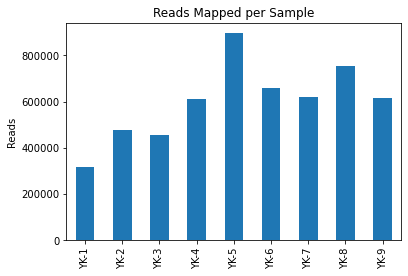

In [4]:
otu_tab.sum(axis=0).plot(kind='bar')
plt.title("Reads Mapped per Sample")
plt.ylabel("Reads")
plt.show()

In [5]:
#Filter out bad zotus from the otu table
otu_tab = otu_tab.loc[zotu_tax.index]
otu_tab.columns=['Soil-1','Soil-2','Soil-3','High-1','High-2','High-3','Low-1','Low-2','Low-3']
otu_tab
#otu_tab.to_csv('all_zotustab2.txt', sep='\t', index_label='#OTU ID')

,Soil-1,Soil-2,Soil-3,High-1,High-2,High-3,Low-1,Low-2,Low-3
0,,,,,,,,,
Zotu4,4.0,0.0,0.0,63679.0,11090.0,9774.0,46965.0,2828.0,5955.0
Zotu1,494.0,834.0,545.0,302548.0,418240.0,307642.0,3044.0,15434.0,23328.0
Zotu2,19.0,10.0,15.0,46678.0,209929.0,112595.0,3119.0,22996.0,12836.0
Zotu7,51.0,140.0,119.0,15895.0,26435.0,41917.0,1665.0,1255.0,2166.0
Zotu5,193.0,1.0,2.0,619.0,526.0,360.0,230.0,911.0,110030.0
...,...,...,...,...,...,...,...,...,...
Zotu8345,3.0,26.0,10.0,0.0,0.0,0.0,0.0,0.0,1.0
Zotu8347,2.0,9.0,14.0,0.0,0.0,0.0,0.0,0.0,0.0
Zotu8348,5.0,9.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0


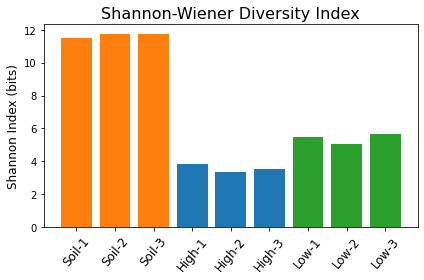

In [6]:
from skbio.diversity import alpha_diversity
import numpy as np
plt.bar(np.arange(0,len(otu_tab.columns)),alpha_diversity('shannon',otu_tab.T),
       color=['tab:orange','tab:orange','tab:orange','tab:blue','tab:blue','tab:blue'
              ,'tab:green','tab:green','tab:green'])
plt.title('Shannon-Wiener Diversity Index', size=16)
plt.xticks(ticks=np.arange(0,len(otu_tab.columns)),labels=otu_tab.columns, rotation=50,size=12)
plt.ylabel('Shannon Index (bits)', size=12)
#plt.xlabel('Sample')
plt.tight_layout()
#plt.savefig('Shannon-Wiener_Diversity_colors.png',dpi=300)

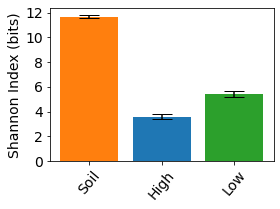

In [9]:
alpha = alpha_diversity('shannon',otu_tab.T)
soil_mean = np.mean(alpha[0:3])
soil_std = np.std(alpha[0:3])
high_mean = np.mean(alpha[3:6])
high_std = np.std(alpha[3:6])
low_mean = np.mean(alpha[6:9])
low_std = np.std(alpha[6:9])
plt.figure(figsize=(4,3))
plt.bar(np.arange(0,3),[soil_mean, high_mean, low_mean], yerr=[soil_std,high_std,low_std],
       capsize=10., color=['tab:orange','tab:blue','tab:green'])
#plt.title('Shannon Diversity Index', size=16)
plt.xticks(ticks=np.arange(0,3),labels=['Soil','High','Low'], rotation=50, size=14)
plt.yticks(size=14)
plt.ylabel('Shannon Index (bits)', size=14)
#plt.xlabel('Sample Group')
plt.tight_layout()
plt.savefig('figures/Shannon_Diversity_mean_color_v2.png',dpi=300)

In [7]:
#ANOVA and post-hoc tests on shannon diversity data
from scipy.stats import f_oneway
soil_div = alpha_diversity('shannon',otu_tab.T)[0:3]
high_div = alpha_diversity('shannon',otu_tab.T)[3:6]
low_div = alpha_diversity('shannon',otu_tab.T)[6:9]

print(f_oneway(soil_div, high_div, low_div))

F_onewayResult(statistic=971.9304967804587, pvalue=2.9136863331549842e-08)


In [15]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd
df = pd.DataFrame({'div': alpha_diversity('shannon', otu_tab.T),
                   'group': np.repeat(['soil', 'high', 'low'], repeats=3)})
print(pairwise_tukeyhsd(endog=df['div'],
                          groups=df['group'],
                          alpha=0.05))

Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj lower  upper  reject
-------------------------------------------------
  high    low   1.8304 0.001 1.2427 2.4181   True
  high   soil   8.0638 0.001 7.4761 8.6515   True
   low   soil   6.2334 0.001 5.6457 6.8211   True
-------------------------------------------------


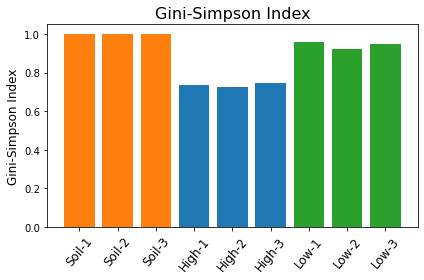

In [107]:
plt.bar(np.arange(0,len(otu_tab.columns)),alpha_diversity('simpson',otu_tab.T),
        color=['tab:orange','tab:orange','tab:orange','tab:blue','tab:blue','tab:blue'
              ,'tab:green','tab:green','tab:green'])
plt.title('Gini-Simpson Index', size=16)
plt.xticks(ticks=np.arange(0,len(otu_tab.columns)),labels=otu_tab.columns, rotation=50, size=12)
plt.ylabel('Gini-Simpson Index', size=12)
plt.tight_layout()
plt.savefig('Gini-Simpson_Diversity_colors.png',dpi=300)

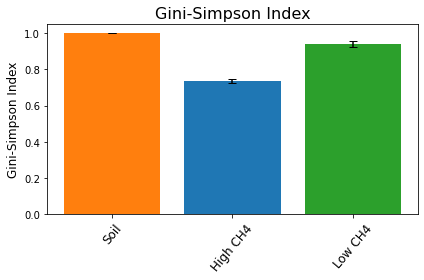

In [108]:
alpha = alpha_diversity('simpson',otu_tab.T)
soil_mean = np.mean(alpha[0:3])
soil_std = np.std(alpha[0:3])
high_mean = np.mean(alpha[3:6])
high_std = np.std(alpha[3:6])
low_mean = np.mean(alpha[6:9])
low_std = np.std(alpha[6:9])
plt.bar(np.arange(0,3),[soil_mean, high_mean, low_mean], yerr=[soil_std,high_std,low_std],
       capsize=4., color=['tab:orange','tab:blue','tab:green'])
plt.title('Gini-Simpson Index', size=16)
plt.xticks(ticks=np.arange(0,3),labels=['Soil','High CH4','Low CH4'], rotation=50, size=12)
plt.ylabel('Gini-Simpson Index', size=12)
#plt.xlabel('Sample Group')
plt.tight_layout()
plt.savefig('Gini-Simpson-Index_mean_color.png',dpi=300)

In [10]:
norm_otu_tab = otu_tab/otu_tab.sum(axis=0)*100
norm_otu_tab.sort_values(by="High-1", ascending=False).head(20)

,Soil-1,Soil-2,Soil-3,High-1,High-2,High-3,Low-1,Low-2,Low-3
0,,,,,,,,,
Zotu1,0.164073,0.182842,0.122422,49.405997,46.750837,46.697612,0.505621,2.048550,3.840986
Zotu4,0.001329,0.000000,0.000000,10.398762,1.239639,1.483616,7.801080,0.375360,0.980499
Zotu2,0.006310,0.002192,0.003369,7.622503,23.465848,17.091027,0.518079,3.052252,2.113465
Zotu7,0.016939,0.030693,0.026731,2.595649,2.954902,6.362668,0.276563,0.166576,0.356635
Zotu50,0.060780,0.065551,0.097264,1.555430,0.011513,0.044020,0.002990,0.012344,0.058616
Zotu62,0.001329,0.000658,0.000674,1.389027,0.177618,0.194749,0.049333,0.013273,0.023710
Zotu21,0.000000,0.000658,0.000000,1.037606,2.313062,1.856872,0.009966,0.082292,0.071459
Zotu88,0.002325,0.008112,0.006065,0.994169,0.005924,0.021251,0.002658,0.006504,0.019758
Zotu17,0.068751,0.096464,0.128038,0.909416,1.185203,0.298271,1.300097,2.459481,0.188526


In [135]:
norm_otu_tab.to_csv("Normalized_OTU_table.csv")

In [11]:
combined = pd.concat([zotu_tax, norm_otu_tab], axis=1)
#combined.to_csv("All_samples_combined_nbc_df.csv")

In [12]:
split_tax = combined.tax.str.split(',', expand=True).fillna('Unclassified').rename(columns={0:'d',1:'p',2:'c',3:'o',4:'f',5:'g'})
split_tax

,d,p,c,o,f,g
0,,,,,,
Zotu4,d:Bacteria,p:Proteobacteria,c:Betaproteobacteria,o:Nitrosomonadales,f:Sterolibacteriaceae,g:Methyloversatilis
Zotu1,d:Bacteria,p:Proteobacteria,c:Alphaproteobacteria,o:Rhizobiales,f:Methylocystaceae,g:Methylocystis
Zotu2,d:Bacteria,p:Proteobacteria,c:Betaproteobacteria,o:Burkholderiales,f:Comamonadaceae,g:Aquabacterium
Zotu7,d:Bacteria,p:Proteobacteria,c:Alphaproteobacteria,o:Rhizobiales,f:Hyphomicrobiaceae,g:Hyphomicrobium
Zotu5,d:Bacteria,Unclassified,Unclassified,Unclassified,Unclassified,Unclassified
...,...,...,...,...,...,...
Zotu8345,d:Bacteria,p:Acidobacteria,c:Acidobacteria_Gp10,Unclassified,Unclassified,Unclassified
Zotu8347,d:Bacteria,Unclassified,Unclassified,Unclassified,Unclassified,Unclassified
Zotu8348,d:Bacteria,p:Chloroflexi,c:Anaerolineae,o:Anaerolineales,f:Anaerolineaceae,Unclassified


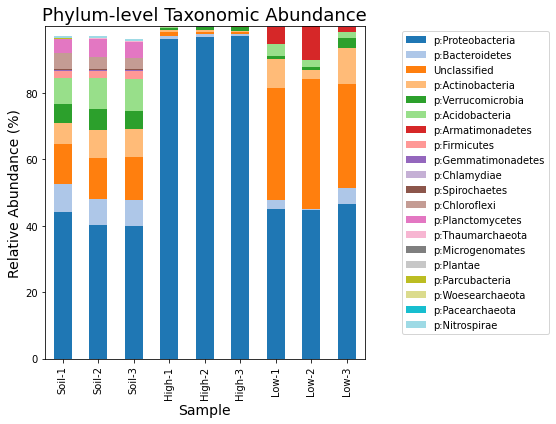

In [38]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('p').sum()
x.sort_values(by='High-1', ascending=False).head(20).T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0))
plt.title('Phylum-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xlabel('Sample', size=14)
plt.tight_layout()
plt.savefig('Phlyum_rel_abundance.png',dpi=300)

In [260]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('g').sum()
x = x.T
x['group'] = np.repeat(['Soil', 'High', 'Low'], 3)
x.groupby('group').mean().T.sort_values(by='Low', ascending=False).head(30)
#x.iloc[:,6:9].std(axis=1).sort_values(ascending=False).head(10)
#x.sort_values(by='Soil-1', ascending=False)

group,High,Low,Soil
g,,,
Unclassified,15.760326,63.791957,73.176934
g:Aquabacterium,16.730661,5.648024,0.180361
g:Mycobacterium,0.327369,4.831095,0.413646
g:Methyloversatilis,4.961137,3.081085,0.001330
g:Reyranella,0.142567,2.613775,0.266232
g:Piscinibacter,0.698486,2.251697,0.086481
g:Methylocystis,50.418786,2.200903,0.203003
g:Immundisolibacter,0.129784,1.574120,0.003653
g:Acidovorax,1.265244,1.569622,0.309740


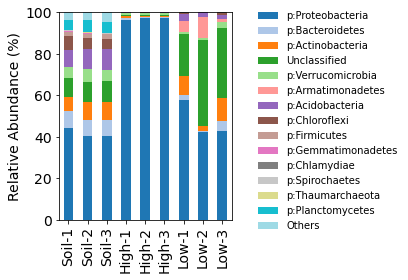

In [29]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('p').sum()
x = x.sort_values(by='High-1', ascending=False).head(14)
others = 100 - x.sum()
x.loc['Others'] = others
x.T.plot.bar(stacked=True, cmap='tab20', figsize=(6,4))
plt.legend(bbox_to_anchor=(1.1,1.05),fontsize=10, frameon=False)
#plt.title('Phylum-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xticks(rotation=90,size=14)
plt.yticks(size=14)
plt.ylim([0,100])
#plt.xlabel('Sample', size=14)
plt.tight_layout()
plt.savefig('figures/Phlyum_rel_abundance_v4_nbc_rdp.png',dpi=300)

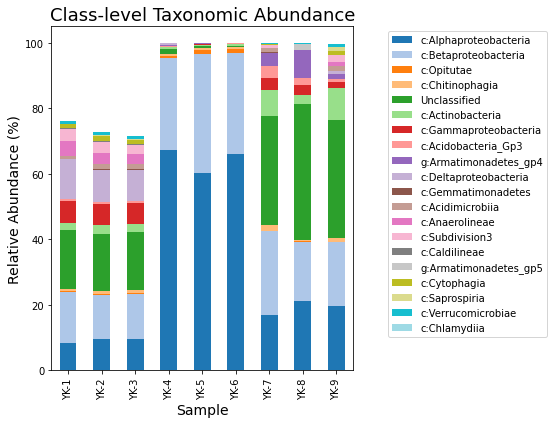

In [296]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('c').sum()
x.sort_values(by='YK-5', ascending=False).head(20).T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0))
plt.title('Class-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xlabel('Sample', size=14)
plt.tight_layout()
plt.savefig('Class_rel_abundance.png',dpi=300)

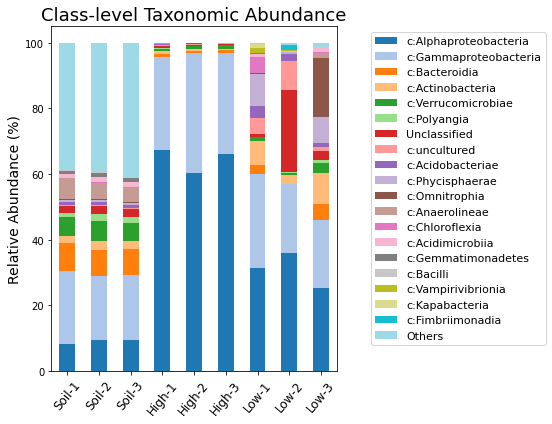

In [95]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('c').sum()
x = x.sort_values(by='High-1', ascending=False).head(19)
others = 100 - x.sum()
x.loc['Others'] = others
x.T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0), fontsize=11)
plt.title('Class-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xticks(rotation=50,size=12)
plt.tight_layout()
plt.savefig('Class_rel_abundance_v2_silva_sintax.png',dpi=300)

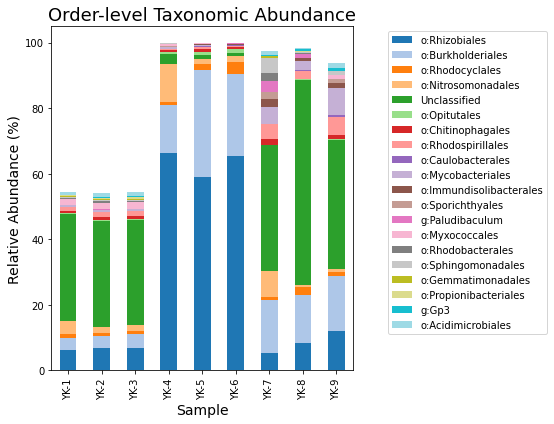

In [297]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('o').sum()
x.sort_values(by='YK-5', ascending=False).head(20).T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0))
plt.title('Order-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xlabel('Sample', size=14)
plt.tight_layout()
plt.savefig('Order_rel_abundance.png',dpi=300)

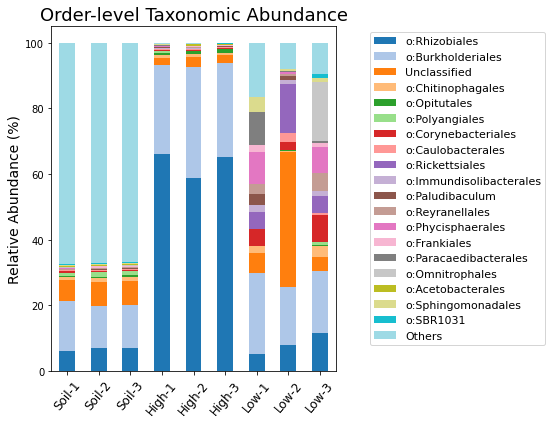

In [96]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('o').sum()
x = x.sort_values(by='High-1', ascending=False).head(19)
others = 100 - x.sum()
x.loc['Others'] = others
x.T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0), fontsize=11)
plt.title('Order-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xticks(rotation=50,size=12)
plt.tight_layout()
plt.savefig('Order_rel_abundance_v2_silva_sintax.png',dpi=300)

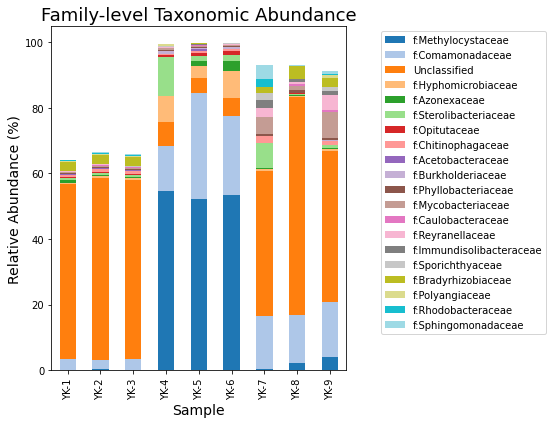

In [298]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('f').sum()
x.sort_values(by='YK-5', ascending=False).head(20).T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0))
plt.title('Family-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xlabel('Sample', size=14)
plt.tight_layout()
plt.savefig('Family_rel_abundance.png',dpi=300)

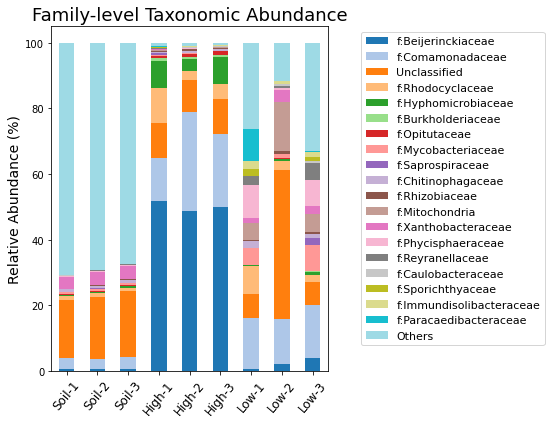

In [97]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('f').sum()
x = x.sort_values(by='High-1', ascending=False).head(19)
others = 100 - x.sum()
x.loc['Others'] = others
x.T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0),fontsize=11)
plt.title('Family-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xticks(rotation=50,size=12)
plt.tight_layout()
plt.savefig('Family_rel_abundance_v2_silva_sintax.png',dpi=300)

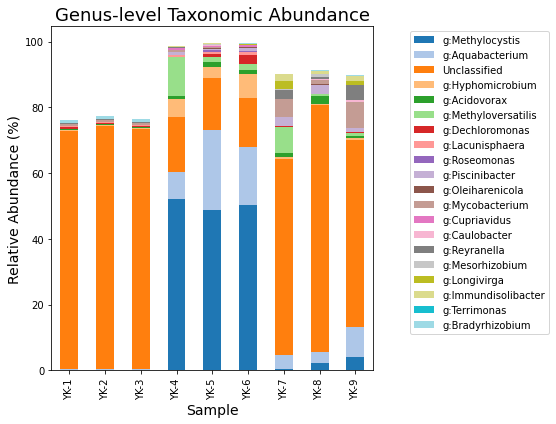

In [300]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('g').sum()
x.sort_values(by='YK-5', ascending=False).head(20).T.plot.bar(stacked=True, cmap='tab20', figsize=(8,6))
plt.legend(bbox_to_anchor=(1.1,1.0))
plt.title('Genus-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xlabel('Sample', size=14)
plt.tight_layout()
plt.savefig('Genus_rel_abundance.png',dpi=300)

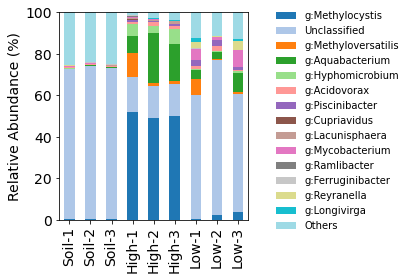

In [30]:
x = norm_otu_tab.join(split_tax, how='outer').groupby('g').sum()
x = x.sort_values(by='High-1', ascending=False).head(14)
others = 100 - x.sum()
x.loc['Others'] = others
x.T.plot.bar(stacked=True, cmap='tab20', figsize=(6,4))
plt.legend(bbox_to_anchor=(1.1,1.05),fontsize=10, frameon=False)
#plt.title('Phylum-level Taxonomic Abundance', size=18)
plt.ylabel('Relative Abundance (%)', size=14)
plt.xticks(rotation=90,size=14)
plt.yticks(size=14)
plt.ylim([0,100])
#plt.xlabel('Sample', size=14)
plt.tight_layout()
plt.savefig('figures/Genus_rel_abundance_v4_nbc_rdp.png',dpi=300)

## Perform Ordination on OTU table

In [35]:
from scipy.spatial.distance import pdist, squareform
from skbio import DistanceMatrix
from skbio.stats.distance import anosim, permanova
from skbio.stats.ordination import pcoa
import seaborn as sn
dist = pdist(norm_otu_tab.T, metric='braycurtis')
square_dist = squareform(dist)
dm = DistanceMatrix(square_dist)
labels = np.repeat(['soil','high','low'],3)
anosim(dm, labels, permutations=9999)

method name                 ANOSIM
test statistic name              R
sample size                      9
number of groups                 3
test statistic            0.983539
p-value                     0.0035
number of permutations        9999
Name: ANOSIM results, dtype: object

In [36]:
permanova(dm, labels, permutations=9999)

method name               PERMANOVA
test statistic name        pseudo-F
sample size                       9
number of groups                  3
test statistic              9.19635
p-value                      0.0035
number of permutations         9999
Name: PERMANOVA results, dtype: object

### PCoA on the distance matrix

In [37]:
pcoa_df = pcoa(square_dist, number_of_dimensions=2).samples
pcoa_df['group'] = list(labels)
pcoa(square_dist, number_of_dimensions=2).proportion_explained

PC1    0.483326
PC2    0.273845
dtype: float64

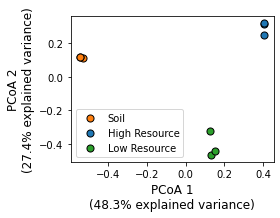

In [42]:
plt.figure(figsize=(4,3))
plt.scatter(pcoa_df.iloc[0:3, 0], pcoa_df.iloc[0:3, 1], color='tab:orange', label='Soil', s=50, edgecolors='black')
plt.scatter(pcoa_df.iloc[3:6, 0], pcoa_df.iloc[3:6, 1], color='tab:blue', label='High Resource',  s=50, edgecolors='black')
plt.scatter(pcoa_df.iloc[6:9, 0], pcoa_df.iloc[6:9, 1], color='tab:green', label='Low Resource',  s=50, edgecolors='black')
#plt.title('PCoA of OTU Table', size=16)
plt.legend(fontsize=10)
plt.xlabel('PCoA 1\n(48.3% explained variance)', size=12)
plt.ylabel('PCoA 2\n(27.4% explained variance)', size=12)
plt.tight_layout()
plt.savefig('figures/PCoA_v2.png', dpi=300)